In [1]:
import json
import numpy as np
from matplotlib import cm
import ipyvolume as ipv

from tyssue import Sheet, SheetGeometry
from tyssue.io import hdf5
from tyssue.draw import sheet_view

%matplotlib inline

### Load a dataset

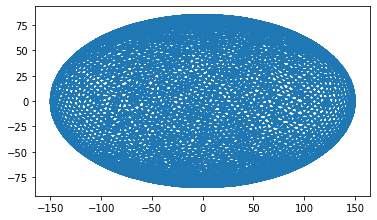

In [46]:
dsets = hdf5.load_datasets('../data/hf5/ellipsoid_sheet_init.hf5',
                           data_names=['vert', 'edge', 'face'])

sheet = Sheet('ellipse', dsets)
sheet.reset_index(order=True)
sheet.reset_topo()

SheetGeometry.update_all(sheet)
fig, ax = sheet_view(sheet, coords=list('zx'), lw=0.2, mode='quick')

### View edges only 

In [3]:
fig, mesh = sheet_view(sheet, color=sheet.vert_df.y, mode='3D')
fig

Figure(camera=PerspectiveCamera(fov=46.0, position=(0.0, 0.0, 2.0), quaternion=(0.0, 0.0, 0.0, 1.0), scale=(1.…

In [4]:
%pdb

Automatic pdb calling has been turned ON


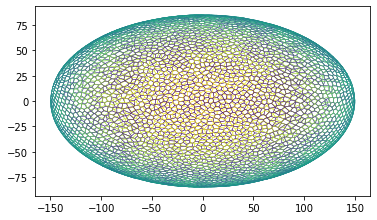

In [7]:
fig2, mesh2 = sheet_view(sheet, coords=['z', 'x', 'y'], edge={"color": sheet.edge_df.sy})

In [45]:
ipv.clear()
fig2, mesh2 = sheet_view(sheet, coords=['z', 'x', 'y'], mode="3D", edge={"color": sheet.vert_df.y})
fig2

Figure(camera=PerspectiveCamera(fov=46.0, position=(0.0, 0.0, 2.0), quaternion=(0.0, 0.0, 0.0, 1.0), scale=(1.…

In [6]:
sheet.edge_df.head()

,dz,ny,dx,nx,length,sub_vol,sub_area,srce,face,cell,...,tx,ty,tz,fx,fy,fz,rx,ry,rz,phi
edge,,,,,,,,,,,,,,,,,,,,,
0,1.469173,2.962939,0.144167,-2.127314,1.588378,79.336497,1.951892,49,0,0,...,-43.935626,55.357551,83.338267,-42.079455,57.458461,81.70196,-2.000338,-1.514659,0.167134,-2.446655
1,2.922365,8.594101,1.937101,-6.247613,3.506698,241.790281,5.667263,50,0,0,...,-41.998525,55.423544,86.260632,-42.079455,57.458461,81.70196,-1.856171,-2.100910,1.636307,-1.968671
2,-5.333656,10.888810,2.293905,-7.931874,7.119758,335.694639,7.184964,0,0,0,...,-39.704620,59.544354,80.926977,-42.079455,57.458461,81.70196,0.080929,-2.034917,4.558672,-1.182731
3,-0.259443,0.631412,-0.019713,-0.463816,0.278679,16.360957,0.415686,710,0,0,...,-39.724333,59.644168,80.667534,-42.079455,57.458461,81.70196,2.374834,2.085893,-0.774983,0.872475
4,-3.518277,11.709399,-3.309497,-8.524514,4.897141,301.014475,7.717235,711,0,0,...,-43.033830,58.837349,77.149257,-42.079455,57.458461,81.70196,2.355121,2.185706,-1.034427,0.945445


### View faces

TODO

In [61]:
canvas, view = sheet_view(
    sheet,
    mode="vispy",
    coords=['z', 'x', 'y'],
    face={
        "visible": True,
        "color": sheet.face_df.area,
        "color_range":[20, 40]
    }
)

VispyWidget(height=720, width=1240)

In [11]:
from tyssue.draw import sheet_view

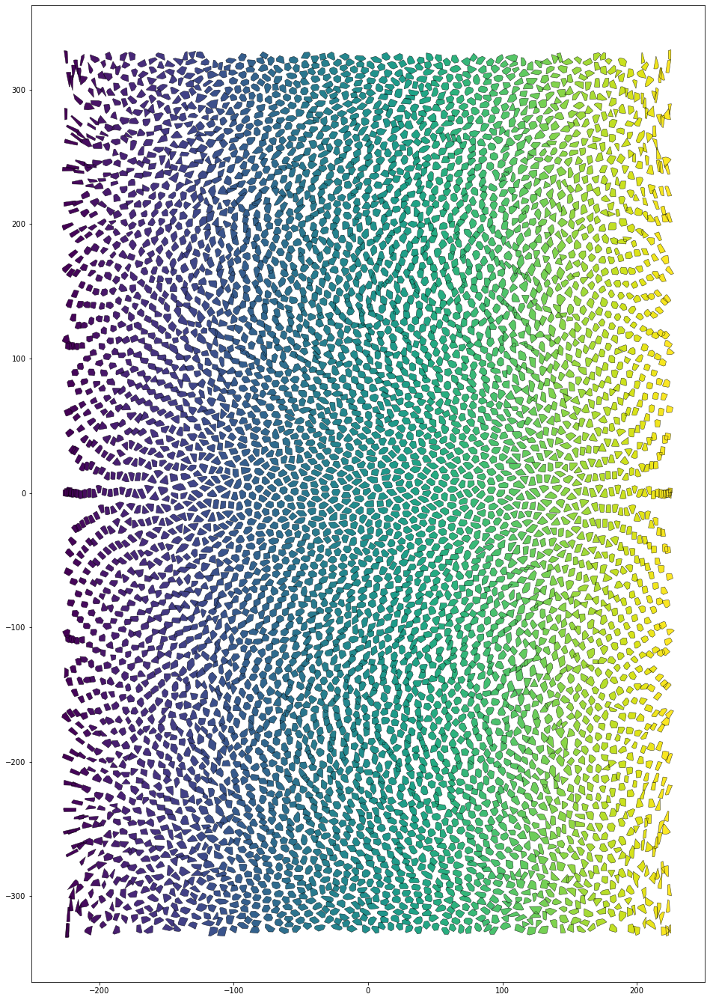

In [68]:
sheet.face_df['theta'] = np.arctan2(sheet.face_df["y"], -sheet.face_df["x"])
sheet.face_df['rho'] = np.linalg.norm(sheet.face_df[["y", "x"]], axis=1)

rxyz = sheet.edge_df[["r" + c for c in sheet.coords]]
dxyz = sheet.edge_df[["d" + c for c in sheet.coords]]
rots = SheetGeometry.face_rotations(sheet)
ruvw = np.einsum("ikj, ik -> ij", rots, rxyz)
duvw = np.einsum("ikj, ik -> ij", rots, dxyz)

for i, c in enumerate('uvw'):
    sheet.edge_df['s'+c] = ruvw[:, i]
    sheet.edge_df['d'+c] = duvw[:, i]
    sheet.edge_df['t'+c] = ruvw[:, i] + duvw[:, i]

x_shift = sheet.upcast_face(sheet.face_df['z']) * 1.5
y_shift = sheet.upcast_face(sheet.face_df['theta']) * sheet.face_df['rho'].mean() * 1.5

sheet.edge_df['su'] += x_shift
sheet.edge_df['sv'] += y_shift

sheet.edge_df['tu'] += x_shift
sheet.edge_df['tv'] += y_shift

fig, ax = sheet_view(
    sheet,
    coords=list('uv'),
    mode="2D",
    edge={"color": '#000000'}, #sheet.edge_df["theta"]},
    face={"visible": True, "color": sheet.face_df["z"]}
)
fig.set_size_inches(24, 24)

#ax.set_xlim(-100, 100)
#ax.set_ylim(-100, 100)


In [30]:
sheet.face_df[['z', 'theta']].head()

,z,theta
face,,
0,81.701960,2.202903
1,86.627034,2.265619
2,86.018044,2.188202
3,84.330785,0.979938
4,76.877985,0.986143
